In [1]:
import bempp.api
from bempp.api.operators.boundary import helmholtz, sparse
from bempp.api.operators.potential import helmholtz as helmholtz_potential
from bempp.api.linalg import gmres
import numpy as np
from matplotlib import pyplot as plt
from math import pi as pi
from math import sqrt as sqrt

rho_0 = 1.22e-12      # Density of air in tonne/mm^3
bulk_modulus = 0.144
c_0 = sqrt(bulk_modulus/rho_0) # Speed of sound in mm/s 
f = 710           # Driving frequency in Hz
omega = 2*pi*f    # Angular frequency in rads/s
k = omega / c_0   # Wavenumber in rads/m


In [4]:
grid = bempp.api.import_grid(r'D:\Work\BEMPP_Cube\Sequentially_Coupled_6_only_x_normal_vel_BEM\MODEL\cube.inp') 
grid.plot()
type(grid)

bempp.api.grid.grid.Grid

In [9]:
grid.vertices[:,121]

array([100., 100.,  70.])

In [5]:
complex_velocity = np.load(fr'D:\Work\BEMPP_Cube\Sequentially_Coupled_6_only_x_normal_vel_BEM\RUN\vel_from_global\numpy_vel\{f}.npy')

# Check the current size of the array
current_size = complex_velocity.shape[0]

# Calculate how many zeros need to be appended
needed_zeros = 602 - current_size

# Pad the array with zeros at the end if needed
if needed_zeros > 0:
    complex_velocity_padded = np.pad(complex_velocity, (0, needed_zeros), 'constant')
else:
    complex_velocity_padded = complex_velocity  # No padding needed if the size matches or exceeds

#print(complex_velocity_padded)




In [6]:
complex_velocity_padded

array([-12.83919   -344.24696j , -12.766604  -344.73826j ,
       -12.690581  -345.2563j  , -12.670925  -345.22602j ,
       -12.64611   -345.34112j , -12.642176  -345.37572j ,
       -12.658864  -345.64449j , -12.702796  -345.88024j ,
       -12.738646  -346.25996j , -12.838448  -345.74479j ,
       -12.855102  -346.14895j , -12.853546  -348.76765j ,
       -12.773323  -348.9411j  , -12.691938  -349.134j   ,
       -12.667051  -348.79253j , -12.635817  -348.59612j ,
       -12.625552  -348.31223j , -12.637185  -348.28043j ,
       -12.676215  -348.21843j , -12.703161  -348.29674j ,
       -12.797762  -347.4594j  , -12.807576  -347.55166j ,
       -12.748097  -347.6027j  , -12.698522  -347.40526j ,
       -12.661289  -347.02724j , -12.630916  -346.54353j ,
       -12.623931  -346.10447j , -12.630973  -345.83385j ,
       -12.661472  -345.55298j , -12.695723  -345.41638j ,
       -12.779677  -344.64564j , -12.793347  -346.77718j ,
       -12.737532  -347.18761j , -12.696321  -347.40741j

In [7]:
spaceP = bempp.api.function_space(grid, "P", 1)
spaceU = bempp.api.function_space(grid, "P", 1)
spaceP.global_dof_count


602

In [8]:
u_total  = bempp.api.GridFunction(spaceU, coefficients=complex_velocity_padded)
u_total.plot(transformation='abs')


In [19]:
complex_velocity.shape

(121,)

In [23]:
u_total.coefficients.shape

(602,)

In [24]:
identity = sparse.identity(spaceP, spaceP, spaceP)
double_layer = helmholtz.double_layer(spaceP, spaceP, spaceP, k)
single_layer = helmholtz.single_layer(spaceU, spaceP, spaceP, k)
type(double_layer)

bempp.api.assembly.boundary_operator.BoundaryOperatorWithAssembler

In [25]:
p_total, info = gmres(double_layer - 0.5 * identity,
                      1j * omega * rho_0 * single_layer * u_total, tol=1E-5)


In [26]:
p_total.coefficients.size


602

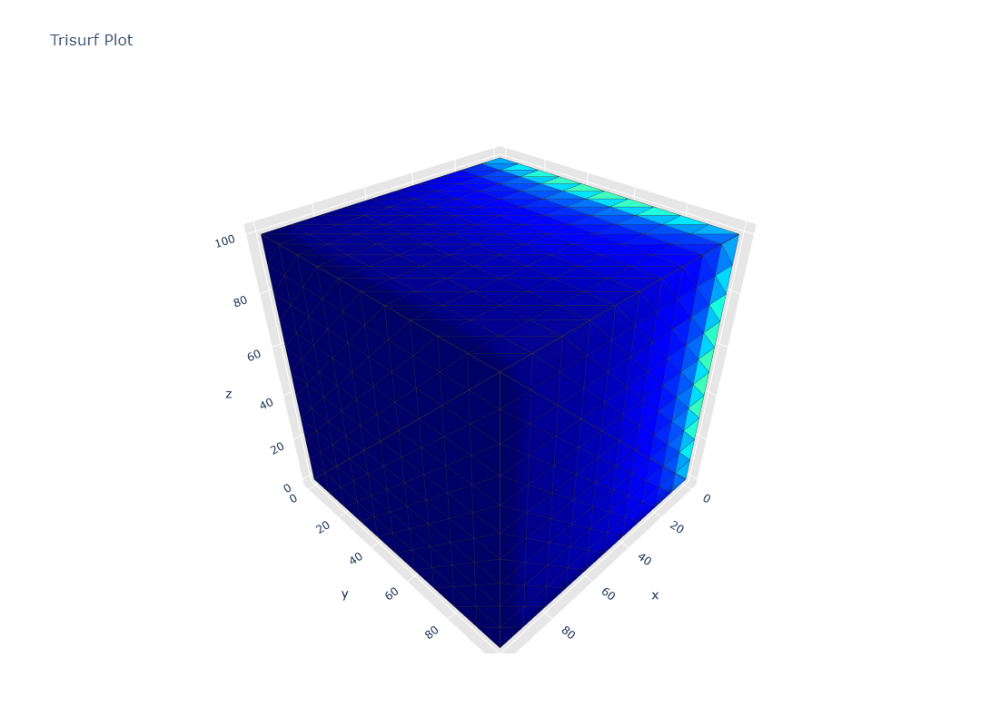

In [28]:
p_total.plot(transformation='abs')

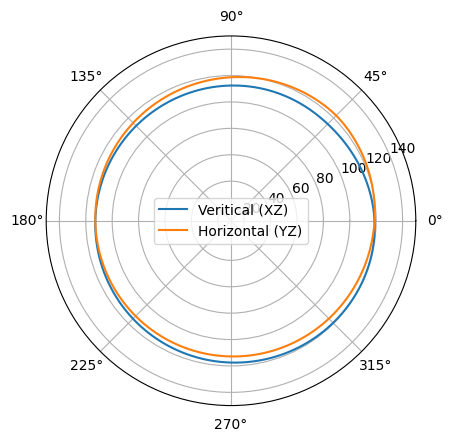

In [29]:
%matplotlib inline

theta = np.linspace(0, 2 * np.pi, 361)
R_far_field = 150       # Evalution radius
p_ref = 2e-11  # dB SPL ref (Pa)

## Compute pattern in XZ plane:
points = R_far_field * np.array([np.sin(theta), np.zeros(len(theta)), np.cos(theta)])
p_XZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
SPL_XZ = 20*np.log10(abs(p_XZ.ravel())/p_ref)
    
## Compute pattern in YZ plane:
points = R_far_field * np.array([np.zeros(len(theta)), np.sin(theta), np.cos(theta)])
p_YZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
SPL_YZ = 20*np.log10(abs(p_YZ.ravel())/p_ref)
 
plt.polar(theta, SPL_XZ, label='Veritical (XZ)')
plt.polar(theta, SPL_YZ, label='Horizontal (YZ)')
plt.legend()
plt.ylim(10, 150)
plt.show()

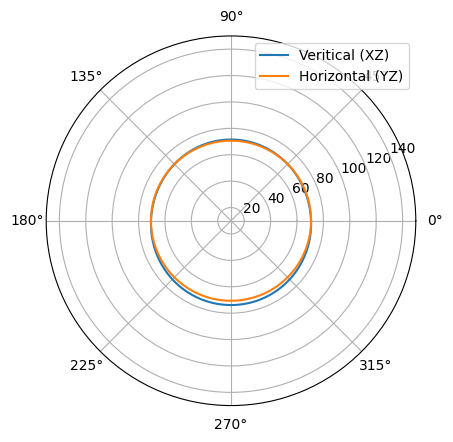

In [30]:
%matplotlib inline

theta = np.linspace(0, 2 * np.pi, 361)
R_far_field = 25000       # Evalution radius
p_ref = 2e-11  # dB SPL ref (Pa)

## Compute pattern in XZ plane:
points = R_far_field * np.array([np.sin(theta), np.zeros(len(theta)), np.cos(theta)])
p_XZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
SPL_XZ = 20*np.log10(abs(p_XZ.ravel())/p_ref)
    
## Compute pattern in YZ plane:
points = R_far_field * np.array([np.zeros(len(theta)), np.sin(theta), np.cos(theta)])
p_YZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
SPL_YZ = 20*np.log10(abs(p_YZ.ravel())/p_ref)
 
plt.polar(theta, SPL_XZ, label='Veritical (XZ)')
plt.polar(theta, SPL_YZ, label='Horizontal (YZ)')
plt.legend()
plt.ylim(10, 150)
plt.show()

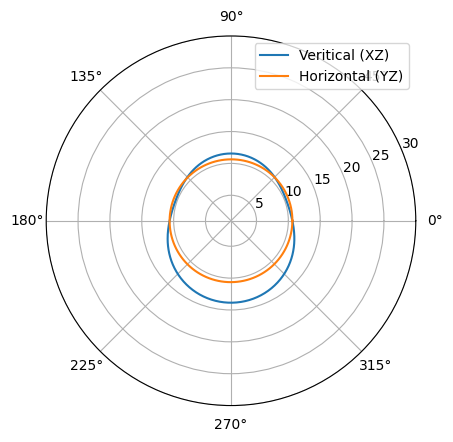

In [31]:
%matplotlib inline

theta = np.linspace(0, 2 * np.pi, 361)
R_far_field = 25000000       # Evalution radius
p_ref = 2e-11  # dB SPL ref (Pa)

## Compute pattern in XZ plane:
points = R_far_field * np.array([np.sin(theta), np.zeros(len(theta)), np.cos(theta)])
p_XZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
SPL_XZ = 20*np.log10(abs(p_XZ.ravel())/p_ref)
    
## Compute pattern in YZ plane:
points = R_far_field * np.array([np.zeros(len(theta)), np.sin(theta), np.cos(theta)])
p_YZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
SPL_YZ = 20*np.log10(abs(p_YZ.ravel())/p_ref)
 
plt.polar(theta, SPL_XZ, label='Veritical (XZ)')
plt.polar(theta, SPL_YZ, label='Horizontal (YZ)')
plt.legend()
plt.ylim(1, 30)
plt.show()

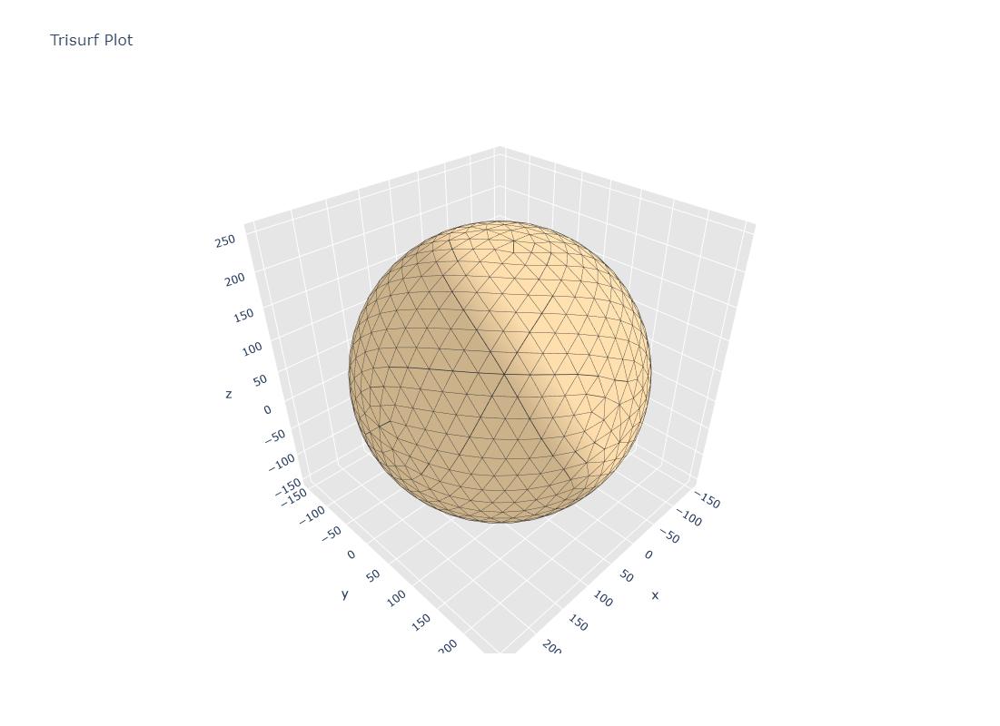

In [32]:
plotting_grid = bempp.api.import_grid(r'C:\Work\BEMPP_Cube\Sequentially_Coupled_6\MODEL\outer_infinite.inp')
plotting_grid.plot()

In [33]:
plotting_grid.vertices[:,-5]

array([248.76736998,  27.82946478,  50.        ])

In [34]:
plotting_grid.vertices[:, plotting_grid.elements[:, -1]]

array([[-111.71347853, -123.55666581, -122.65003798],
       [ 123.67708257,  120.96192407,   99.40984724],
       [ 141.76294659,  119.58799526,  138.03767023]])

C:\Users\sp-stud\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\bempp\api\assembly\discrete_boundary_operator.py:639: SparseEfficiencyWarning:

splu converted its input to CSC format



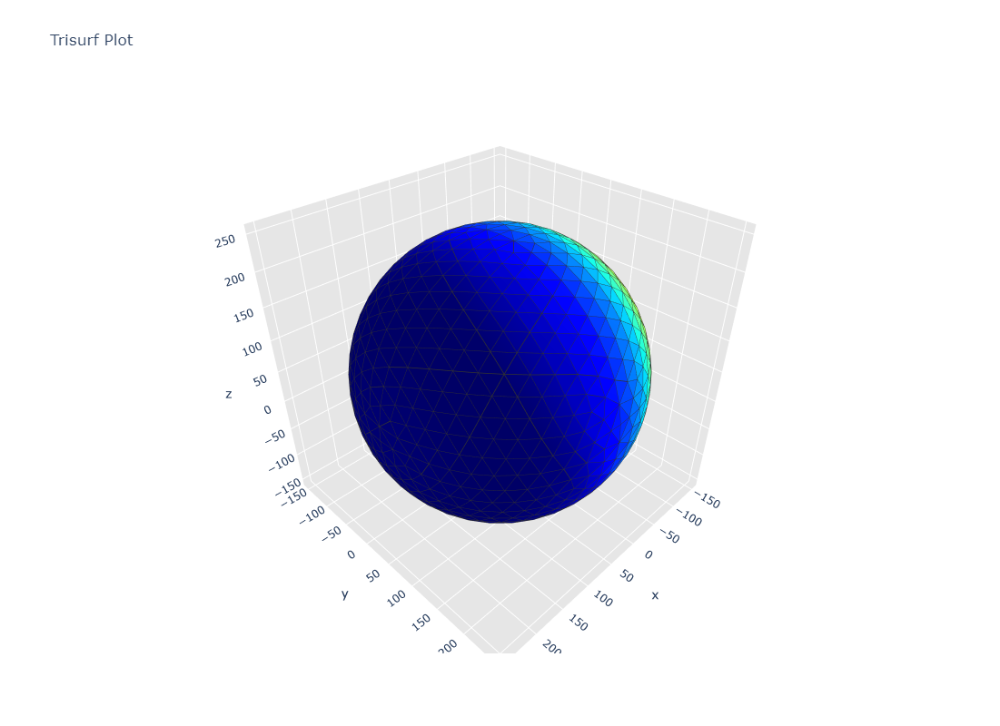

In [35]:
plotting_space = bempp.api.function_space(plotting_grid, "P", 1, include_boundary_dofs=True)
double_layer_plotting = helmholtz.double_layer(spaceP, plotting_space, plotting_space, k)
single_layer_plotting = helmholtz.single_layer(spaceU, plotting_space, plotting_space, k)
p_plotting = double_layer_plotting * p_total - 1j * omega * rho_0 * single_layer_plotting * u_total
p_plotting.plot(transformation='abs')

In [36]:
type(p_plotting)

bempp.api.assembly.grid_function.GridFunction

In [37]:
#p_plotting.coefficients


In [38]:
type(p_plotting.coefficients)
bempp_por = p_plotting.coefficients

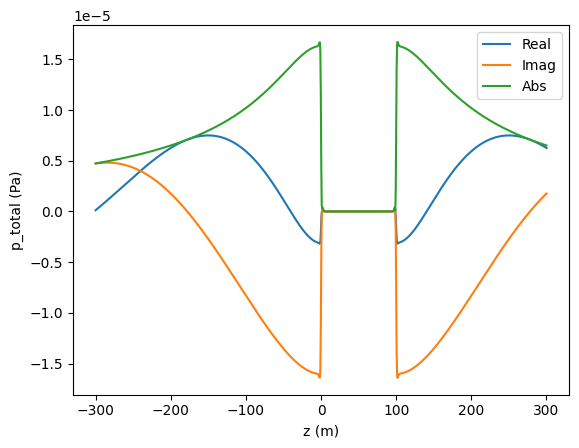

In [58]:
%matplotlib inline

center_x = 50  # Adjust if necessary
center_y = 50  
z = np.linspace(-300, 300, 1000)
points = np.array([np.full(len(z), center_x), np.full(len(z), center_y), z])
pZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
    
plt.plot(z, np.real(pZ.ravel()), label='Real')
plt.plot(z, np.imag(pZ.ravel()), label='Imag')
plt.plot(z, np.abs(pZ.ravel()), label='Abs')
plt.legend()
plt.xlabel('z (m)')
plt.ylabel('p_total (Pa)')
plt.show()

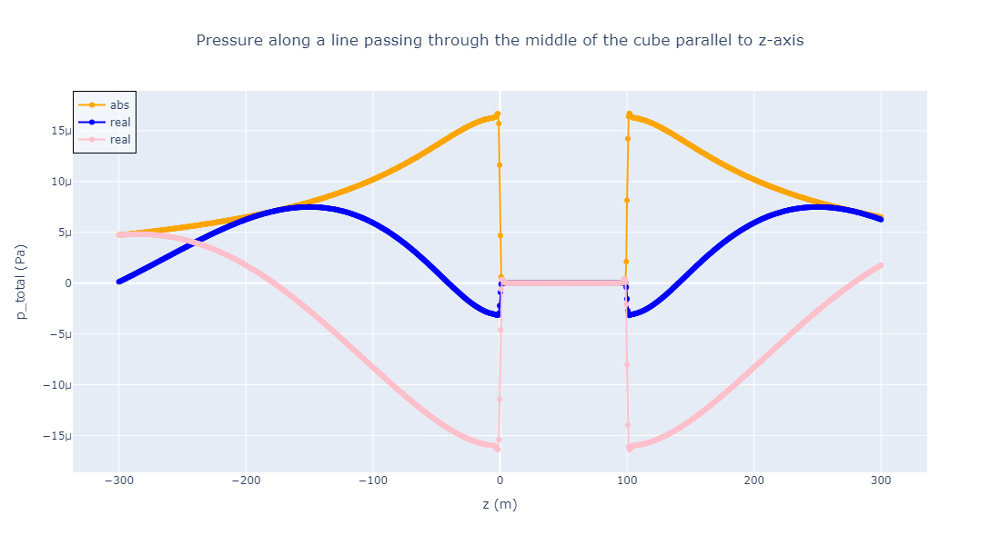

In [60]:
import plotly.graph_objs as go

# Create a trace for each dataset
trace1 = go.Scatter(
    x=z,
    y=np.abs(pZ.ravel()),  # Convert pressures to absolute
    mode='lines+markers',
    name='abs',
    line=dict(color='orange')
)

trace2 = go.Scatter(
    x=z,
    y=np.real(pZ.ravel()),  # Convert pressures to real
    mode='lines+markers',
    name='real',
    line=dict(color='blue')
)

trace3 = go.Scatter(
    x=z,
    y=np.imag(pZ.ravel()),  # Convert pressures to real
    mode='lines+markers',
    name='real',
    line=dict(color='pink')
)

# Layout of the plot
layout = go.Layout(
    title='Pressure along a line passing through the middle of the cube parallel to z-axis',
    title_x=0.5,  # Center the title
    xaxis=dict(title='z (m)'),
    yaxis=dict(title='p_total (Pa)'),
    hovermode='closest',  # Enable hover
    width=1200,  # Width of the plot
    height=600,   # Height of the plot
    #plot_bgcolor='rgb(204, 255, 204)',  # Transparent background for the plot area
    legend=dict(
        x=0,
        y=1,
        traceorder="normal",
        font=dict(
            size=12,
        ),
        bgcolor='rgba(255,255,255,0.5)',  # Semi-transparent background for the legend
        bordercolor='Black',
        borderwidth=1
    )
)

# Combine traces and layout in a figure
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)

# Show the plot
fig.show()

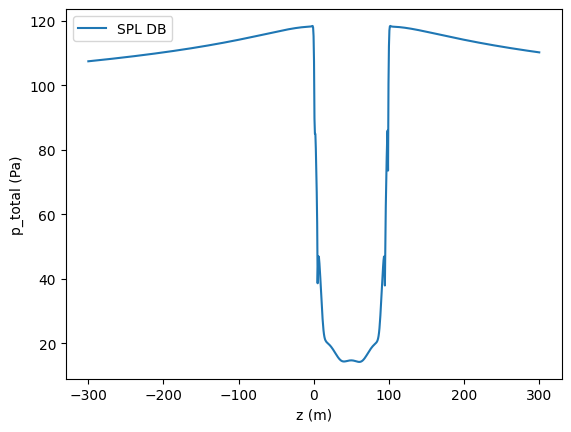

In [43]:
%matplotlib inline

p_ref = 2e-11 
center_x = 50  # Adjust if necessary
center_y = 50  
z = np.linspace(-300, 300, 1000)
points = np.array([np.full(len(z), center_x), np.full(len(z), center_y), z])
pZ = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
    
plt.plot(z, 20 * np.log10(np.abs(pZ.ravel())/p_ref), label='SPL DB')
plt.legend()
plt.xlabel('z (m)')
plt.ylabel('p_total (Pa)')
plt.show()

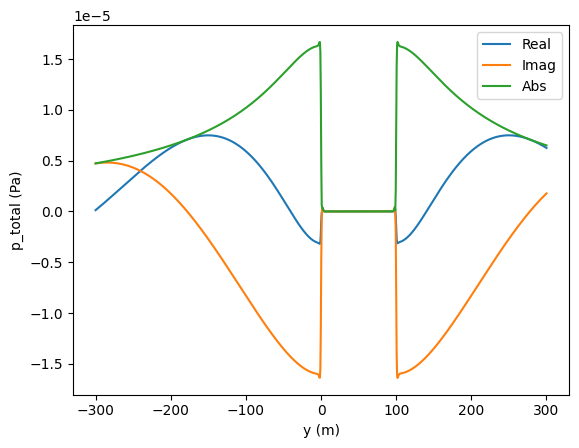

In [44]:
%matplotlib inline

center_x = 50  # Adjust if necessary
center_z = 50  
y = np.linspace(-300, 300, 1000)
points = np.array([np.full(len(y), center_x), y, np.full(len(y), center_z)])
pY = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
    
plt.plot(y, np.real(pY.ravel()), label='Real')
plt.plot(y, np.imag(pY.ravel()), label='Imag')
plt.plot(y, np.abs(pY.ravel()), label='Abs')
plt.legend()
plt.xlabel('y (m)')
plt.ylabel('p_total (Pa)')
plt.show()

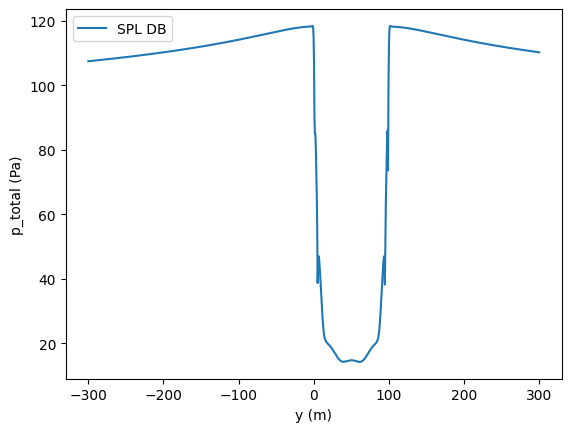

In [45]:
%matplotlib inline

center_x = 50  # Adjust if necessary
center_z = 50  
y = np.linspace(-300, 300, 1000)
points = np.array([np.full(len(y), center_x), y, np.full(len(y), center_z)])
pY = helmholtz_potential.double_layer(spaceP, points, k) * p_total  \
     - 1j * omega * rho_0 * helmholtz_potential.single_layer(spaceU, points, k) * u_total
plt.plot(y, 20 * np.log10(np.abs(pY.ravel())/p_ref), label='SPL DB')
plt.legend()
plt.xlabel('y (m)')
plt.ylabel('p_total (Pa)')
plt.show()

In [46]:
np.full(len(z), center_x)
len(z)

1000

In [47]:
z = np.linspace(-200, 200, 150)
points = np.array([np.zeros(len(z)), np.zeros(len(z)), z])

In [48]:
points.shape

(3, 150)

In [51]:
abaqus_por = np.load(fr'C:\Work\BEMPP_Cube\Sequentially_Coupled_6\RUN\por_from_abaqus\{f}.npy')
abaqus_por

array([-6.8661739e-07+1.3532966e-05j, -8.5519631e-07+1.3731270e-05j,
       -9.3394332e-07+1.3817245e-05j, -1.0413586e-06+1.3939278e-05j,
       -1.0610668e-06+1.3922385e-05j,  2.2240565e-06+1.0271812e-05j,
        3.7166723e-06+8.1513354e-06j,  4.9531617e-06+5.6271549e-06j,
        3.9665274e-06+7.6692910e-06j,  4.9268186e-06+5.6346559e-06j,
        4.8929561e-06+5.7191318e-06j,  4.5568960e-06+6.5975363e-06j,
        3.3130954e-06+8.7745143e-06j,  2.5340551e-06+9.8256790e-06j,
        4.8839740e-06+5.7010693e-06j,  4.8683884e-06+5.7423477e-06j,
        4.4545885e-06+6.7384383e-06j,  4.5565211e-06+6.5198738e-06j,
        4.5074276e-06+6.6289949e-06j,  4.1413459e-06+7.3172518e-06j,
        3.6206940e-06+8.2650382e-06j,  2.9931469e-06+9.2534102e-06j,
        3.9772924e-06+7.6839553e-06j,  3.4520638e-06+8.5489140e-06j,
        4.0758704e-06+7.5104294e-06j,  3.9165837e-06+7.7498232e-06j,
        3.2611864e-06+8.7856117e-06j,  2.5992805e-06+9.7742369e-06j,
        1.9274494e-06+1.0689156e-0

In [52]:
def plot_complex_comparison(abaqus_por, bempp_por):
    plt.figure(figsize=(12, 10))

    # Subplot 1: Absolute Values
    plt.subplot(2, 2, 1)
    plt.plot(np.abs(abaqus_por), label='Absolute - Abaqus')
    plt.plot(np.abs(bempp_por), label='Absolute - BEMPP', linestyle='--')
    plt.title('Comparison of Absolute Values')
    plt.xlabel('Node_Index')
    plt.ylabel('Magnitude')
    plt.legend()

    # Subplot 2: Phases
    plt.subplot(2, 2, 2)
    plt.plot(np.angle(abaqus_por, deg=True), label='Phase - Abaqus')
    plt.plot(np.angle(bempp_por, deg=True), label='Phase - BEMPP', linestyle='--')
    plt.title('Comparison of Phases')
    plt.xlabel('Node_Index')
    plt.ylabel('Phase (degrees)')
    plt.legend()

    # Subplot 3: Real Parts
    plt.subplot(2, 2, 3)
    plt.plot(np.real(abaqus_por), label='Real Part - Abaqus')
    plt.plot(np.real(bempp_por), label='Real Part - BEMPP', linestyle='--')
    plt.title('Comparison of Real Parts')
    plt.xlabel('Node_Index')
    plt.ylabel('Real Value')
    plt.legend()

    # Subplot 4: Imaginary Parts
    plt.subplot(2, 2, 4)
    plt.plot(np.imag(abaqus_por), label='Imaginary Part - Abaqus')
    plt.plot(np.imag(bempp_por), label='Imaginary Part - BEMPP', linestyle='--')
    plt.title('Comparison of Imaginary Parts')
    plt.xlabel('Node_Index')
    plt.ylabel('Imaginary Value')
    plt.legend()

    plt.tight_layout()  # Adjusts subplot params so that subplots fit into the figure area.
    plt.show()


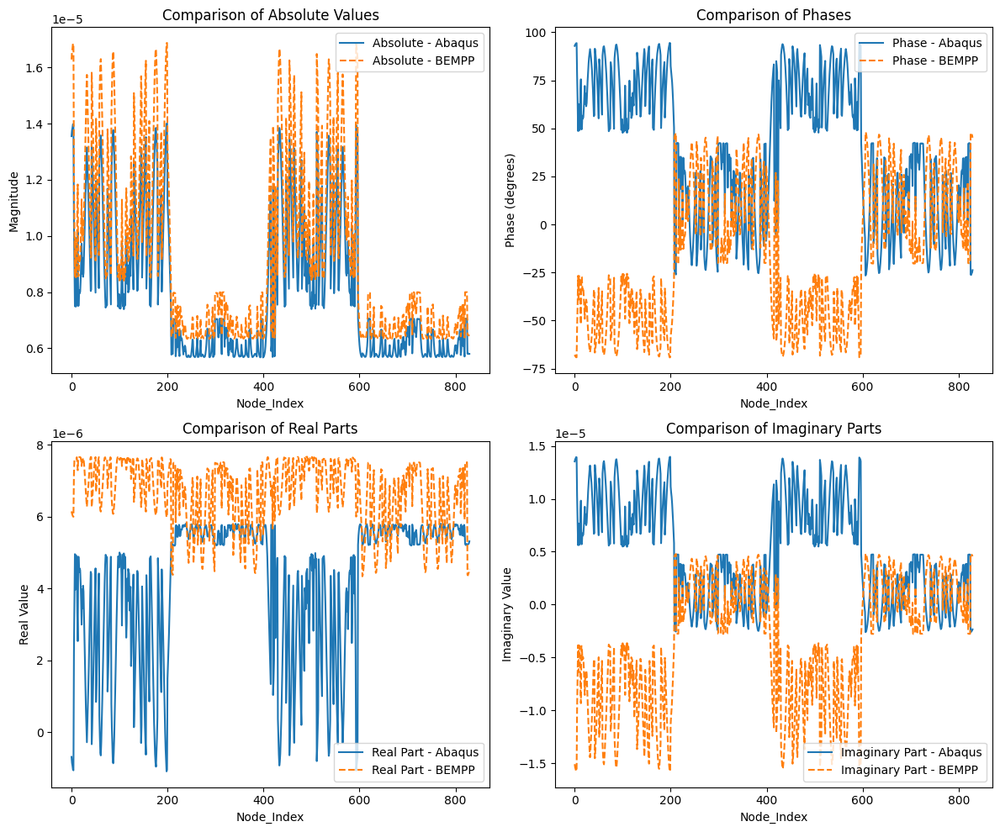

In [53]:
plot_complex_comparison(abaqus_por, bempp_por)

In [54]:
def plot_spl(abaqus_por, bempp_por, p_ref=2e-11):
    plt.figure(figsize=(10, 6))
    
    # Calculate SPL values in dB
    spl_abaqus = 20 * np.log10(np.abs(abaqus_por) / p_ref)
    spl_bempp = 20 * np.log10(np.abs(bempp_por) / p_ref)
    
    # Plotting SPL for Abaqus and BEMPP data
    plt.plot(spl_abaqus, label='SPL - Abaqus', linestyle='-')
    plt.plot(spl_bempp, label='SPL - BEMPP', linestyle='--')
    
    plt.title('Comparison of Sound Pressure Level (SPL) in dB')
    plt.xlabel('Node_Index')
    plt.ylabel('SPL (dB)')
    plt.legend()
    plt.grid(True)
    plt.show()


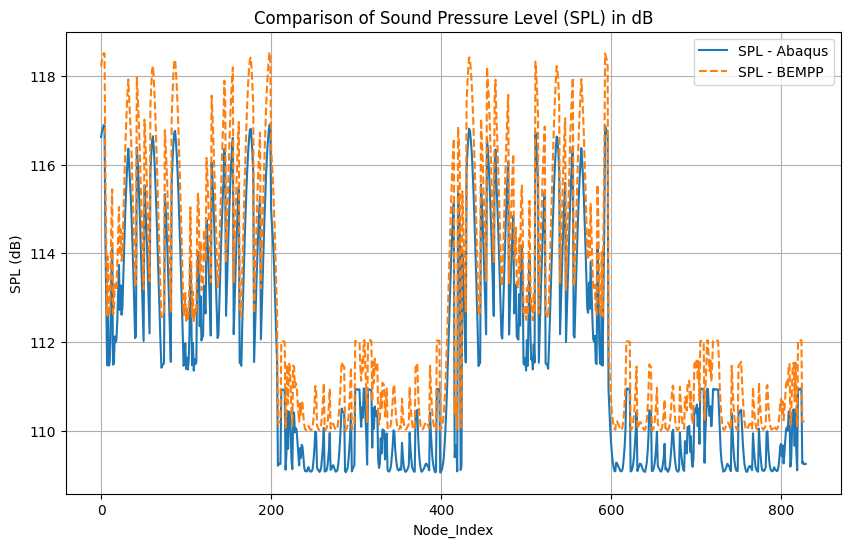

In [55]:
plot_spl(abaqus_por, bempp_por)

In [56]:
temp = np.load(r'C:\Work\BEMPP_Cube\Sequentially_Coupled_6\RUN\vel_from_global\numpy_vel\710.npy')
temp

array([-12.83919   -344.24696j , -12.766604  -344.73826j ,
       -12.690581  -345.2563j  , -12.670925  -345.22602j ,
       -12.64611   -345.34112j , -12.642176  -345.37572j ,
       -12.658864  -345.64449j , -12.702796  -345.88024j ,
       -12.738646  -346.25996j , -12.838448  -345.74479j ,
       -12.855102  -346.14895j , -12.853546  -348.76765j ,
       -12.773323  -348.9411j  , -12.691938  -349.134j   ,
       -12.667051  -348.79253j , -12.635817  -348.59612j ,
       -12.625552  -348.31223j , -12.637185  -348.28043j ,
       -12.676215  -348.21843j , -12.703161  -348.29674j ,
       -12.797762  -347.4594j  , -12.807576  -347.55166j ,
       -12.748097  -347.6027j  , -12.698522  -347.40526j ,
       -12.661289  -347.02724j , -12.630916  -346.54353j ,
       -12.623931  -346.10447j , -12.630973  -345.83385j ,
       -12.661472  -345.55298j , -12.695723  -345.41638j ,
       -12.779677  -344.64564j , -12.793347  -346.77718j ,
       -12.737532  -347.18761j , -12.696321  -347.40741j